In [97]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import random
%matplotlib inline

from ydata_profiling import ProfileReport
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import  cross_val_score
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from mlxtend.plotting import plot_confusion_matrix
from imblearn.over_sampling import SMOTE
from sklearn.utils import resample
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier, export_graphviz, plot_tree
import tensorflow as tf
from tensorflow.keras import regularizers

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
euro_df = pd.read_csv('/home/marcus/LinCode/DataEngineerProject/Kaggle Dataset/song_data.csv', encoding= 'latin-1') 
regions = pd.read_csv('/home/marcus/LinCode/DataEngineerProject/Kaggle Dataset/country_data.csv')

In [3]:
euro_df.head()

,year,semi_final,semi_draw_position,final_draw_position,country,artist_name,song_name,language,style,direct_qualifier_10,...,final_jury_votes,final_place,final_total_points,semi_place,semi_televote_points,semi_jury_points,semi_total_points,favourite_10,race,host_10
0,2023,1,1,20,Norway,Alessandra,Queen of Kings,English,Pop,0,...,11.0,5.0,268.0,6.0,102.0,NaN,102.0,0,unknown,0.0
1,2023,1,2,NaN,Malta,The Busker,Dance (Our Own Party),English,Pop,-,...,NaN,NaN,NaN,15.0,3.0,NaN,3.0,0,unknown,0.0
2,2023,1,3,5,Serbia,Luke Black,Samo mi se spava,"Serbian, English",Pop,0,...,6.0,24.0,30.0,10.0,37.0,NaN,37.0,0,unknown,0.0
3,2023,1,4,NaN,Latvia,Sudden Lights,Aija,English,Rock,-,...,NaN,NaN,NaN,11.0,34.0,NaN,34.0,0,unknown,0.0
4,2023,1,5,2,Portugal,Mimicat,Ai coraï¿½ï¿½o,Portuguese,Pop,0,...,9.0,23.0,59.0,9.0,74.0,NaN,74.0,0,unknown,0.0


In [4]:
euro_df.dtypes

year                       int64
semi_final                object
semi_draw_position        object
final_draw_position       object
country                   object
artist_name               object
song_name                 object
language                  object
style                     object
direct_qualifier_10       object
gender                    object
main_singers               int64
age                       object
selection                 object
key                       object
BPM                       object
energy                    object
danceability              object
happiness                 object
loudness                  object
acousticness              object
instrumentalness          object
liveness                  object
speechiness               object
release_date              object
key_change_10             object
backing_dancers            int64
backing_singers            int64
backing_instruments        int64
instrument_10              int64
qualified_

In [5]:
quali_df = euro_df[['year', 'semi_final', 'semi_draw_position', 'country', 'language', 
                   'style', 'gender', 'main_singers', 'key', 'BPM', 'energy', 'danceability', 
                   'happiness', 'loudness', 'acousticness', 'backing_dancers', 
                   'backing_singers', 'backing_instruments', 'qualified_10']]

In [6]:
quali_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 565 entries, 0 to 564
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   year                 565 non-null    int64 
 1   semi_final           565 non-null    object
 2   semi_draw_position   565 non-null    object
 3   country              565 non-null    object
 4   language             565 non-null    object
 5   style                565 non-null    object
 6   gender               565 non-null    object
 7   main_singers         565 non-null    int64 
 8   key                  565 non-null    object
 9   BPM                  565 non-null    object
 10  energy               565 non-null    object
 11  danceability         565 non-null    object
 12  happiness            565 non-null    object
 13  loudness             539 non-null    object
 14  acousticness         565 non-null    object
 15  backing_dancers      565 non-null    int64 
 16  backing_

In [7]:
quali_df = quali_df[quali_df['qualified_10'] != '-']

In [8]:
quali_df = quali_df.replace('-', np.nan)

In [9]:
quali_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 485 entries, 0 to 559
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   year                 485 non-null    int64 
 1   semi_final           485 non-null    object
 2   semi_draw_position   485 non-null    object
 3   country              485 non-null    object
 4   language             485 non-null    object
 5   style                485 non-null    object
 6   gender               485 non-null    object
 7   main_singers         485 non-null    int64 
 8   key                  469 non-null    object
 9   BPM                  469 non-null    object
 10  energy               469 non-null    object
 11  danceability         469 non-null    object
 12  happiness            469 non-null    object
 13  loudness             469 non-null    object
 14  acousticness         457 non-null    object
 15  backing_dancers      485 non-null    int64 
 16  backing_singe

In [10]:
quali_df['acousticness'].fillna('12', inplace = True)

In [11]:
quali_df[quali_df.isnull().any(axis=1)]

,year,semi_final,semi_draw_position,country,language,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness,acousticness,backing_dancers,backing_singers,backing_instruments,qualified_10
276,2016,2,17,Albania,English,Pop,Female,1,NaN,NaN,NaN,NaN,NaN,NaN,12,0,3,0,0
285,2015,1,2,Armenia,English,Pop,Mix,6,NaN,NaN,NaN,NaN,NaN,NaN,12,0,0,0,1
292,2015,1,9,Serbia,English,Pop,Female,1,NaN,NaN,NaN,NaN,NaN,NaN,12,0,4,0,1
297,2015,1,14,Albania,English,Pop,Female,1,NaN,NaN,NaN,NaN,NaN,NaN,12,0,3,0,1
302,2015,2,3,San Marino,English,Pop,Mix,2,NaN,NaN,NaN,NaN,NaN,NaN,12,0,4,0,0
306,2015,2,7,Portugal,Portuguese,Ballad,Female,1,NaN,NaN,NaN,NaN,NaN,NaN,12,0,4,0,0
328,2014,1,6,Albania,English,Ballad,Female,1,NaN,NaN,NaN,NaN,NaN,NaN,12,0,2,2,0
333,2014,1,11,Moldova,English,Ballad,Female,1,NaN,NaN,NaN,NaN,NaN,NaN,12,4,0,0,0
340,2014,2,2,Israel,"English,ï¿½Hebrew",Pop,Female,1,NaN,NaN,NaN,NaN,NaN,NaN,12,2,0,0,0
342,2014,2,4,Georgia,English,Traditional,Mix,2,NaN,NaN,NaN,NaN,NaN,NaN,12,1,0,1,0


In [12]:
quali_df = quali_df.dropna()
quali_df

,year,semi_final,semi_draw_position,country,language,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness,acousticness,backing_dancers,backing_singers,backing_instruments,qualified_10
0,2023,1,1,Norway,English,Pop,Female,1,E Minor,110,36,64,23,10 dB,58,4,0,0,1
1,2023,1,2,Malta,English,Pop,Male,1,F Minor,103,78,70,82,6 dB,2,0,0,2,0
2,2023,1,3,Serbia,"Serbian, English",Pop,Male,1,A Major,103,70,56,11,10 dB,4,4,0,0,1
3,2023,1,4,Latvia,English,Rock,Male,1,A Minor,160,55,56,40,8 dB,5,0,0,3,0
4,2023,1,5,Portugal,Portuguese,Pop,Female,1,Fs Minor,145,63,66,77,8 dB,31,4,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,2009,2,15,Moldova,"Romanian, English",Traditional,Female,1,Fs Minor,90,86,57,52,5 dB,4,4,1,0,1
556,2009,2,16,Albania,English,Dance,Female,1,Ab Minor,128,67,68,67,8 dB,0,3,2,0,1
557,2009,2,17,Ukraine,English,Pop,Female,1,Fs Minor,125,92,61,85,4 dB,1,5,0,0,1
558,2009,2,18,Estonia,Estonian,Ballad,Female,1,F Minor,124,72,69,64,6 dB,3,0,2,3,1


In [13]:
def language(x):
    if x == 'English': return 'English'
    elif x.find(',') > 0: return 'Mixed' #if there is a comma it means that more than 1 language was used in a song
    else: return 'Native'

In [14]:
quali_df['language2'] = quali_df['language'].apply(language)

In [15]:
quali_df

,year,semi_final,semi_draw_position,country,language,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness,acousticness,backing_dancers,backing_singers,backing_instruments,qualified_10,language2
0,2023,1,1,Norway,English,Pop,Female,1,E Minor,110,36,64,23,10 dB,58,4,0,0,1,English
1,2023,1,2,Malta,English,Pop,Male,1,F Minor,103,78,70,82,6 dB,2,0,0,2,0,English
2,2023,1,3,Serbia,"Serbian, English",Pop,Male,1,A Major,103,70,56,11,10 dB,4,4,0,0,1,Mixed
3,2023,1,4,Latvia,English,Rock,Male,1,A Minor,160,55,56,40,8 dB,5,0,0,3,0,English
4,2023,1,5,Portugal,Portuguese,Pop,Female,1,Fs Minor,145,63,66,77,8 dB,31,4,0,0,1,Native
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,2009,2,15,Moldova,"Romanian, English",Traditional,Female,1,Fs Minor,90,86,57,52,5 dB,4,4,1,0,1,Mixed
556,2009,2,16,Albania,English,Dance,Female,1,Ab Minor,128,67,68,67,8 dB,0,3,2,0,1,English
557,2009,2,17,Ukraine,English,Pop,Female,1,Fs Minor,125,92,61,85,4 dB,1,5,0,0,1,English
558,2009,2,18,Estonia,Estonian,Ballad,Female,1,F Minor,124,72,69,64,6 dB,3,0,2,3,1,Native


In [16]:
quali_df = quali_df.drop(['language'], axis=1)
col = quali_df.pop('language2')
quali_df.insert(4, col.name, col)
quali_df

,year,semi_final,semi_draw_position,country,language2,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness,acousticness,backing_dancers,backing_singers,backing_instruments,qualified_10
0,2023,1,1,Norway,English,Pop,Female,1,E Minor,110,36,64,23,10 dB,58,4,0,0,1
1,2023,1,2,Malta,English,Pop,Male,1,F Minor,103,78,70,82,6 dB,2,0,0,2,0
2,2023,1,3,Serbia,Mixed,Pop,Male,1,A Major,103,70,56,11,10 dB,4,4,0,0,1
3,2023,1,4,Latvia,English,Rock,Male,1,A Minor,160,55,56,40,8 dB,5,0,0,3,0
4,2023,1,5,Portugal,Native,Pop,Female,1,Fs Minor,145,63,66,77,8 dB,31,4,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,2009,2,15,Moldova,Mixed,Traditional,Female,1,Fs Minor,90,86,57,52,5 dB,4,4,1,0,1
556,2009,2,16,Albania,English,Dance,Female,1,Ab Minor,128,67,68,67,8 dB,0,3,2,0,1
557,2009,2,17,Ukraine,English,Pop,Female,1,Fs Minor,125,92,61,85,4 dB,1,5,0,0,1
558,2009,2,18,Estonia,Native,Ballad,Female,1,F Minor,124,72,69,64,6 dB,3,0,2,3,1


In [17]:
quali_df.rename(columns = {'language2': 'language', 'loudness':'loudness(dB)'}, inplace=True)

In [18]:
quali_df['loudness(dB)'] = quali_df['loudness(dB)'].str.replace(' dB', '')
quali_df

,year,semi_final,semi_draw_position,country,language,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness(dB),acousticness,backing_dancers,backing_singers,backing_instruments,qualified_10
0,2023,1,1,Norway,English,Pop,Female,1,E Minor,110,36,64,23,10,58,4,0,0,1
1,2023,1,2,Malta,English,Pop,Male,1,F Minor,103,78,70,82,6,2,0,0,2,0
2,2023,1,3,Serbia,Mixed,Pop,Male,1,A Major,103,70,56,11,10,4,4,0,0,1
3,2023,1,4,Latvia,English,Rock,Male,1,A Minor,160,55,56,40,8,5,0,0,3,0
4,2023,1,5,Portugal,Native,Pop,Female,1,Fs Minor,145,63,66,77,8,31,4,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,2009,2,15,Moldova,Mixed,Traditional,Female,1,Fs Minor,90,86,57,52,5,4,4,1,0,1
556,2009,2,16,Albania,English,Dance,Female,1,Ab Minor,128,67,68,67,8,0,3,2,0,1
557,2009,2,17,Ukraine,English,Pop,Female,1,Fs Minor,125,92,61,85,4,1,5,0,0,1
558,2009,2,18,Estonia,Native,Ballad,Female,1,F Minor,124,72,69,64,6,3,0,2,3,1


In [19]:
quali_df.dtypes

year                    int64
semi_final             object
semi_draw_position     object
country                object
language               object
style                  object
gender                 object
main_singers            int64
key                    object
BPM                    object
energy                 object
danceability           object
happiness              object
loudness(dB)           object
acousticness           object
backing_dancers         int64
backing_singers         int64
backing_instruments     int64
qualified_10           object
dtype: object

We create a training_set where we drop all songs from <code>2023</code> and drop <code>year</code> and <code>semi_final</code> since they are not relevant for training the model.

In [20]:
mask = quali_df['year'] == 2023
training_df = quali_df[~mask].drop(['year', 'semi_final'], axis=1)

In [21]:
training_df

,semi_draw_position,country,language,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness(dB),acousticness,backing_dancers,backing_singers,backing_instruments,qualified_10
37,1,Albania,Mixed,Pop,Female,1,F Minor,100,70,76,45,6,5,5,0,0,0
38,2,Latvia,English,Pop,Male,1,B Minor,115,69,75,59,8,1,0,0,4,0
39,3,Lithuania,Native,Ballad,Female,1,C Major,93,56,68,50,8,9,0,0,0,1
40,4,Switzerland,English,Ballad,Male,1,F Major,116,18,42,39,11,87,0,0,0,1
41,5,Slovenia,Native,Pop,Male,1,E Minor,120,61,68,60,6,0,0,0,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
555,15,Moldova,Mixed,Traditional,Female,1,Fs Minor,90,86,57,52,5,4,4,1,0,1
556,16,Albania,English,Dance,Female,1,Ab Minor,128,67,68,67,8,0,3,2,0,1
557,17,Ukraine,English,Pop,Female,1,Fs Minor,125,92,61,85,4,1,5,0,0,1
558,18,Estonia,Native,Ballad,Female,1,F Minor,124,72,69,64,6,3,0,2,3,1


In [22]:
def type_transform(df: pd.DataFrame, cat_cols: list, pass_cols):

    """_summary_

    Returns:
        _type_: _description_
    """

    cols = df.columns
    for col in cols:
        if col in cat_cols:
            df[col] = df[col].astype('category')
        elif col in pass_cols:
            pass
        else:
            df[col] = df[col].astype('int64')

    return df.dtypes

In [23]:
type_transform(training_df, ['country', 'language', 'style', 'gender'], ['key'])

semi_draw_position        int64
country                category
language               category
style                  category
gender                 category
main_singers              int64
key                      object
BPM                       int64
energy                    int64
danceability              int64
happiness                 int64
loudness(dB)              int64
acousticness              int64
backing_dancers           int64
backing_singers           int64
backing_instruments       int64
qualified_10              int64
dtype: object

## OneHot Encode

In [24]:
colours = [
    'cornflowerblue', 'mediumaquamarine', 'lightcoral', 'paleturquoise',
    'lemonchiffon', 'lavender', 'rosybrown', 'palegoldenrod', 
    'lightsteelblue', 'thistle', 'chartreuse', 'mediumspringgreen',
    'moccasin', 'cornflowerblue', 'darkorchid', 'fuchsia', 'peachpuff']

In [25]:
def plot_cats(df, cols, colours = colours):
    """
    Plot bar charts for each categorical variable in the specified dataframe.

    Args:
        df: A pandas dataframe.
        cols: A list of strings representing the categorical variable columns to plot.
        colours: A list of strings representing the colors to use for each bar chart.

    Returns:
        None
    """

    for col in cols:
        
        values = df[col].value_counts()
        colour = random.choice(colours)
        params = {'xtick.labelsize': 9, 'ytick.labelsize': 10}
        mpl.rcParams.update(params)
        plt.bar(
            x = values.keys(), 
            height = values.values,
            color = colour
            )
        plt.xticks(rotation = 90)
        plt.title(col)
        plt.show()

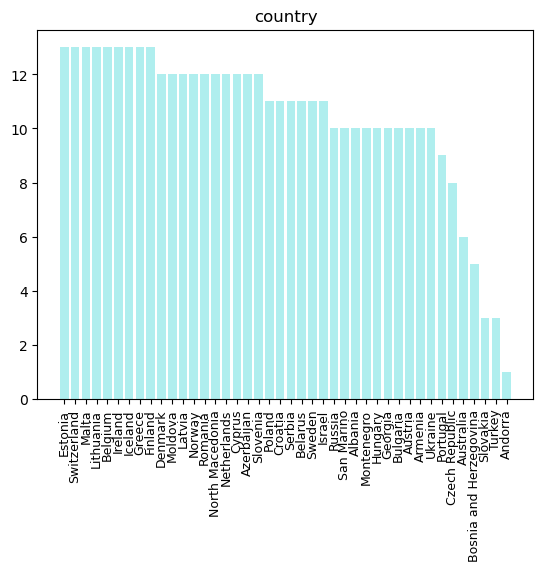

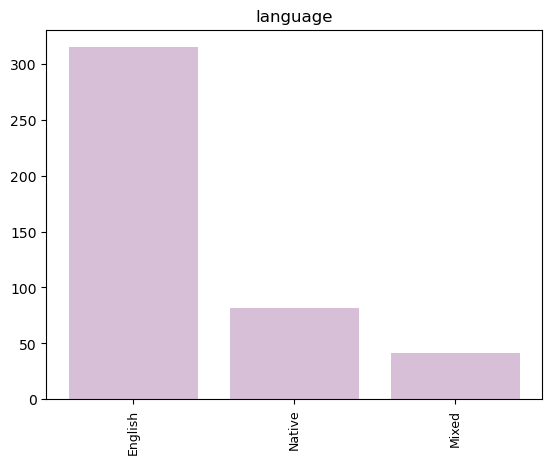

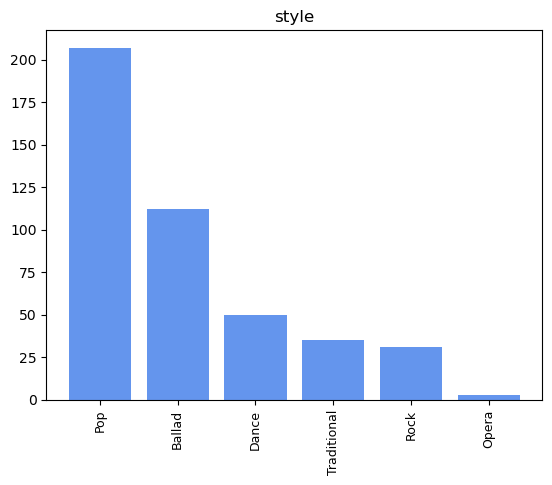

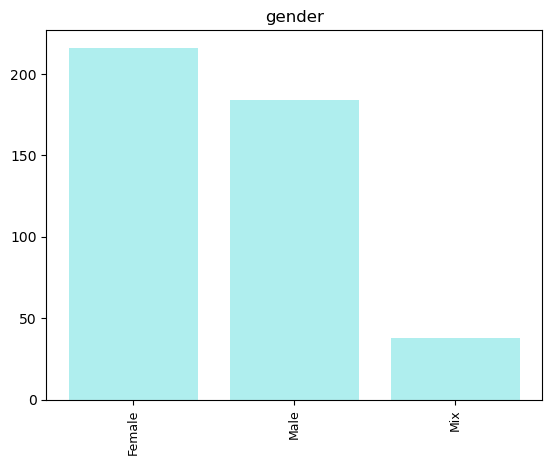

In [26]:
plot_cats(training_df, [col for col in training_df.columns if training_df[col].dtype == "category"])

In [27]:
training_df = training_df.reset_index()
training_df = training_df.drop(['index'], axis=1)
training_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 438 entries, 0 to 437
Data columns (total 17 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   semi_draw_position   438 non-null    int64   
 1   country              438 non-null    category
 2   language             438 non-null    category
 3   style                438 non-null    category
 4   gender               438 non-null    category
 5   main_singers         438 non-null    int64   
 6   key                  438 non-null    object  
 7   BPM                  438 non-null    int64   
 8   energy               438 non-null    int64   
 9   danceability         438 non-null    int64   
 10  happiness            438 non-null    int64   
 11  loudness(dB)         438 non-null    int64   
 12  acousticness         438 non-null    int64   
 13  backing_dancers      438 non-null    int64   
 14  backing_singers      438 non-null    int64   
 15  backing_instruments  43

In [28]:
# We create a copy of the dataset
training_encoded = training_df.copy()

# Define columns in which we'll perform one hot encoding
onehot_cols = ['country', 'language', 'style', 'gender']

# One hot encoding
onehot = OneHotEncoder(drop = 'first')
onehot_cols_encoded = pd.DataFrame(onehot.fit_transform(training_df[onehot_cols]).toarray())
onehot_cols_encoded.columns = onehot.get_feature_names_out()
training_encoded.drop(onehot_cols, axis = 1, inplace = True)
training_encoded = pd.concat([training_encoded, onehot_cols_encoded], axis = 1)
training_encoded.head(5)

,semi_draw_position,main_singers,key,BPM,energy,danceability,happiness,loudness(dB),acousticness,backing_dancers,...,country_Ukraine,language_Mixed,language_Native,style_Dance,style_Opera,style_Pop,style_Rock,style_Traditional,gender_Male,gender_Mix
0,1,1,F Minor,100,70,76,45,6,5,5,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,2,1,B Minor,115,69,75,59,8,1,0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,3,1,C Major,93,56,68,50,8,9,0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4,1,F Major,116,18,42,39,11,87,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,5,1,E Minor,120,61,68,60,6,0,0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


## LabelEncoding

In [29]:
# Dictionary with key and its frequency in Hz
frequencies = {
    'A Minor': 220.00,
    'A Major' : 440.0,
    'Ab Major': 415.30,
    'Ab Minor': 207.65,
    'As Major': 466.16,
    'As Minor': 233.08,
    'B Major': 493.88,
    'B Minor': 246.94,
    'Bb Major': 466.16,
    'Bb Minor': 233.08,
    'C Major': 261.63,
    'C Minor': 130.81,
    'Cs Major': 554.37,
    'Cs Minor': 277.18,
    'D Major': 293.66,
    'D Minor': 146.83,
    'Db Major': 554.37,
    'Db Minor': 277.18,
    'Ds Minor': 311.13,
    'E Major': 329.63,
    'E Minor': 164.81,
    'Eb Major': 622.25,
    'Eb Minor': 311.13,
    'F Major': 349.23,
    'F Minor': 174.61,
    'Fs Major': 739.99,
    'Fs Minor': 369.99,
    'G Major': 392.00,
    'G Minor': 196.00,
    'Gs Major': 415.30,
    'Gs Minor': 415.65
}

# Replace values in the `key` column with their frequencies in Hz
training_encoded['key'] = training_encoded['key'].replace(frequencies)

training_encoded.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 438 entries, 0 to 437
Data columns (total 63 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   semi_draw_position              438 non-null    int64  
 1   main_singers                    438 non-null    int64  
 2   key                             438 non-null    float64
 3   BPM                             438 non-null    int64  
 4   energy                          438 non-null    int64  
 5   danceability                    438 non-null    int64  
 6   happiness                       438 non-null    int64  
 7   loudness(dB)                    438 non-null    int64  
 8   acousticness                    438 non-null    int64  
 9   backing_dancers                 438 non-null    int64  
 10  backing_singers                 438 non-null    int64  
 11  backing_instruments             438 non-null    int64  
 12  qualified_10                    438 

In [30]:
prediction_df = quali_df[mask]
prediction_df = prediction_df[[i for i in prediction_df.columns if i in list(training_df.columns)]]
prediction_df = prediction_df.drop(['qualified_10'], axis=1)
prediction_df.head(5)

,semi_draw_position,country,language,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness(dB),acousticness,backing_dancers,backing_singers,backing_instruments
0,1,Norway,English,Pop,Female,1,E Minor,110,36,64,23,10,58,4,0,0
1,2,Malta,English,Pop,Male,1,F Minor,103,78,70,82,6,2,0,0,2
2,3,Serbia,Mixed,Pop,Male,1,A Major,103,70,56,11,10,4,4,0,0
3,4,Latvia,English,Rock,Male,1,A Minor,160,55,56,40,8,5,0,0,3
4,5,Portugal,Native,Pop,Female,1,Fs Minor,145,63,66,77,8,31,4,0,0


In [31]:
prediction_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31 entries, 0 to 30
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   semi_draw_position   31 non-null     object
 1   country              31 non-null     object
 2   language             31 non-null     object
 3   style                31 non-null     object
 4   gender               31 non-null     object
 5   main_singers         31 non-null     int64 
 6   key                  31 non-null     object
 7   BPM                  31 non-null     object
 8   energy               31 non-null     object
 9   danceability         31 non-null     object
 10  happiness            31 non-null     object
 11  loudness(dB)         31 non-null     object
 12  acousticness         31 non-null     object
 13  backing_dancers      31 non-null     int64 
 14  backing_singers      31 non-null     int64 
 15  backing_instruments  31 non-null     int64 
dtypes: int64(4), ob

In [32]:
type_transform(prediction_df, ['country', 'language', 'style', 'gender'], ['key'])

semi_draw_position        int64
country                category
language               category
style                  category
gender                 category
main_singers              int64
key                      object
BPM                       int64
energy                    int64
danceability              int64
happiness                 int64
loudness(dB)              int64
acousticness              int64
backing_dancers           int64
backing_singers           int64
backing_instruments       int64
dtype: object

In [33]:
# Apply one hot encoding to the same columns that we did in the training dataset
prediction_encoded = prediction_df.copy()
onehot_cols = ['country', 'language', 'style', 'gender']
onehot = OneHotEncoder(drop = 'first')
onehot_cols_encoded_pred = pd.DataFrame(onehot.fit_transform(prediction_df[onehot_cols]).toarray())
onehot_cols_encoded_pred.columns = onehot.get_feature_names_out()
prediction_encoded.drop(onehot_cols, axis = 1, inplace = True)
prediction_encoded = pd.concat([prediction_encoded, onehot_cols_encoded_pred], axis = 1)

In [34]:
# Replace key with their frequencies in Hz
prediction_encoded['key'] = prediction_encoded['key'].replace(frequencies)

In [35]:
# Identify the missing columns
missing_cols = [i for i in training_encoded.columns if i not in prediction_encoded.columns]
missing_cols

['qualified_10',
 'country_Andorra',
 'country_Belarus',
 'country_Bosnia and Herzegovina',
 'country_Bulgaria',
 'country_Hungary',
 'country_Montenegro',
 'country_North Macedonia',
 'country_Russia',
 'country_Slovakia',
 'country_Turkey',
 'country_Ukraine',
 'style_Dance',
 'style_Opera']

In [36]:
# Removing our target variable, 'qualified_10', from the missing columns list since that shouldn't be in the predictions dataset
missing_cols.remove('qualified_10')

In [37]:
# Add the missing columns to predict dataset
prediction_encoded[missing_cols] = 0


# EDA

In [38]:
# Pandas profiling to create the report
training_report = ProfileReport(training_encoded, title='Training Profile Report')
training_report.to_file("training_report.html")
training_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### categories with high correlation
> backing_instruments - style_rock 0.522 <br>
> danceability - happiness 0.585 <br>
> energy - acousticness -0.520 <br>
> energy - happiness 0.538 <br>
> energy - loudness(dB) -0.672 <br>
> gender_mix - main_singers 0.701 <br>
> loudness(dB) - country_Andorra 0.694 <br>

### Balancing target variable

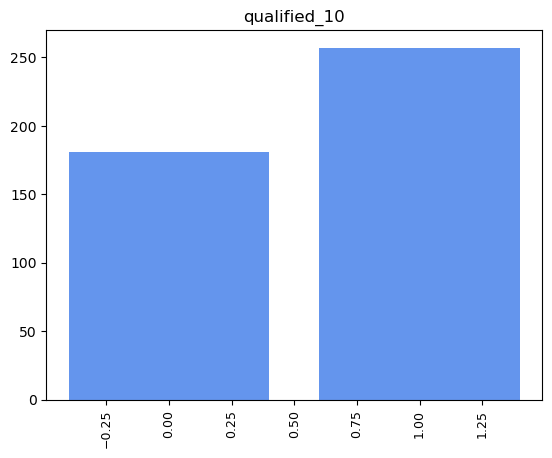

In [39]:
# X y split of the dataset and drop highly correlated columns
X = training_encoded.drop('qualified_10', axis=1)
X.drop(['backing_instruments', 'danceability','energy', 'gender_Mix', 'country_Andorra'], axis = 1, inplace = True)
y= training_encoded['qualified_10']
prediction_encoded = prediction_encoded.loc[:, list(X.columns)]
plot_cats(training_encoded, ["qualified_10"])

In [40]:
# # SMOTE
# smote = SMOTE(random_state=42)
# X_smote, y_smote = smote.fit_resample(X, y)

# # Check whether the target variable is now balanced or not
# print(y_smote.value_counts())

In [41]:
# #RANDOM OVERSAMPLING

# # Randomly choose rows from the minority class
# minority_samples = X[y == 0]
# n_samples = X[y == 1].shape[0]

# minority_upsampled = resample(minority_samples, 
#                   replace=True, 
#                   n_samples=n_samples, 
#                   random_state=42)

# # Merge the rows we've just created with the majority class
# X_upsampled = pd.concat([X[y == 1], minority_upsampled])
# y_upsampled = pd.concat([y[y == 1],pd.Series([0] * n_samples)])

# # Check whether the target variable is now balanced or not
# print(y_upsampled.value_counts())

### Standardization

We split the dataset into training and testing sets to evaluate the model's performance on new data.  
Additionally, we use Standard Scaler to ensure that features are on the same scale and to improve model performance by preventing any particular feature from dominating the others.


Since we want to study which method delivers the best results for our case, we're gonna standardize the dataset balanced using SMOTE and the dataset balanced using Random Oversampling separately, and we are going to train and test different models with both of them.


#### SMOTE training and test data

In [42]:
# Train and test split 85-15 ratio
X_smote_train, X_smote_test, y_smote_train, y_smote_test = train_test_split(X, y, test_size=0.15, random_state=66)

# Apply standard scaler
scaler = StandardScaler()
X_scaled_smote_train = scaler.fit_transform(X_smote_train)
X_scaled_smote_test = scaler.transform(X_smote_test)

#### Random oversampling training and test data

In [43]:
# Train and test split 85-15 ratio
X_upsampled_train, X_upsampled_test, y_upsampled_train, y_upsampled_test = train_test_split(X, y, test_size=0.15, random_state=66)

# Apply standard scaler
scaler = StandardScaler()
X_scaled_os_train = scaler.fit_transform(X_upsampled_train)
X_scaled_os_test = scaler.transform(X_upsampled_test)

#### Prediction dataset - 2023

In [44]:
# Apply standard scaler
scaler = StandardScaler()
scaled_23 = scaler.fit_transform(prediction_encoded)

## Models

In order to predict which countries will be in the top 5 of this year's Eurovision contest based on song data from 2009, we have selected three different machine learning models to evaluate their performance.


<b>Decision Tree Classifier</b>: <br>

<b>Logistic Regression</b>: <br>
We chose logistic regression because it is a widely-used and effective classification algorithm that can be used to predict binary outcomes. Since our target variable is a binary indicator for whether a country qualifies or not, logistic regression is a natural choice. It also has the advantage of being a simple and interpretable model, making it easier to understand the relationship between the features and the target variable.


<b>Random Forest</b>: <br>
Random forest is an ensemble learning algorithm that combines multiple decision trees to create a more accurate and robust model. It is a good choice for our problem because it can handle non-linear relationships between the features and the target variable, and can also handle high-dimensional data. Random forest also has the advantage of being less prone to overfitting than a single decision tree, which can be useful when working with a limited dataset.


<b>Neural Network</b>: <br>
Neural networks are a powerful class of machine learning algorithms that can be used for a wide range of classification and regression problems. We chose to use a neural network because it has the potential to capture complex and non-linear relationships between the features and the target variable, which may be important for accurately predicting which countries qualify. Neural networks can also handle high-dimensional data and can be trained using a variety of optimization algorithms. However, neural networks are typically more complex than other models, and can be more difficult to interpret.

In [45]:
def statistics(model, X_test, y_test):

    """
    Calculate and print various statistics (accuracy, precision, recall, and F1 score) 
    for a given classification model and test data. Also, plot a confusion matrix.

    Args:
    model: a trained classification model with a predict() method.
    X_test: input data to test the model on.
    y_test: true labels corresponding to the input data.

    Returns:
    None
    """

    from sklearn.metrics import confusion_matrix
    y_pred = model.predict(X_test)
    confusion_matrix = confusion_matrix(y_test, y_pred)

    accuracy = accuracy_score(y_test, y_pred)
    print('Accuracy: %f' % accuracy)

    precision = precision_score(y_test, y_pred)
    print('Precision: %f' % precision)

    recall = recall_score(y_test, y_pred)
    print('Recall: %f' % recall)

    f1 = f1_score(y_test, y_pred)
    print('F1 score: %f' % f1)

    plot_confusion_matrix(conf_mat=confusion_matrix, figsize=(6, 6), cmap=plt.cm.RdPu)
    plt.suptitle("Confusion matrix")
    plt.show()

In [46]:
def nn_statistics(model, X_test, y_test):
    """
    Calculate and print various statistics (accuracy, precision, recall, and F1 score) 
    for a given classification model and test data. Also, plot a confusion matrix.

    Args:
    model: a trained classification model with a predict() method.
    X_test: input data to test the model on.
    y_test: true labels corresponding to the input data.

    Returns:
    None
    """
    
    from sklearn.metrics import confusion_matrix


    y_pred = model.predict(X_test).flatten()
    y_pred = [np.round(i).astype(int) for i in y_pred]
    confusion_matrix = confusion_matrix(y_test, y_pred)
    plot_confusion_matrix(conf_mat=confusion_matrix, figsize=(6, 6), cmap=plt.cm.RdPu)
    plt.suptitle("Confusion matrix")
    plt.show()

    accuracy = accuracy_score(y_test, y_pred)
    print('Accuracy: %f' % accuracy)

    precision = precision_score(y_test, y_pred)
    print('Precision: %f' % precision)

    recall = recall_score(y_test, y_pred)
    print('Recall: %f' % recall)

    f1 = f1_score(y_test, y_pred)
    print('F1 score: %f' % f1)

In [47]:
def predict_qualified_2023(model, data_2023):
    """
    Predict countries that will qualify for 2023.

    Args:
    - model: chosen model for prediction.
    - data_2023: prediction dataset.

    Returns:
    - np.ndarray: Array of countries that are predicted to qualify.
    """

    prediction_m1_2023= model.predict(data_2023)

    countries = prediction_df['country']

    qual = pd.concat([countries, pd.DataFrame(prediction_m1_2023)], axis=1)
    print(f"Model predicts {len(qual[qual[0] == 1])} countries will make it to the final")
    return qual[qual[0] == 1]

### SMOTE Dataset

#### DecisionTree

Fitting 5 folds for each of 12312 candidates, totalling 61560 fits
[CV] END criterion=gini, max_depth=None, max_features=None, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=None, max_features=None, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=None, max_features=None, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=None, max_features=None, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=None, max_features=None, min_samples_leaf=1, min_samples_split=2; total time=   0.0s
[CV] END criterion=gini, max_depth=None, max_features=None, min_samples_leaf=1, min_samples_split=3; total time=   0.0s
[CV] END criterion=gini, max_depth=None, max_features=None, min_samples_leaf=1, min_samples_split=3; total time=   0.0s
[CV] END criterion=gini, max_depth=None, max_features=None, min_samples_leaf=1, min_samples_s

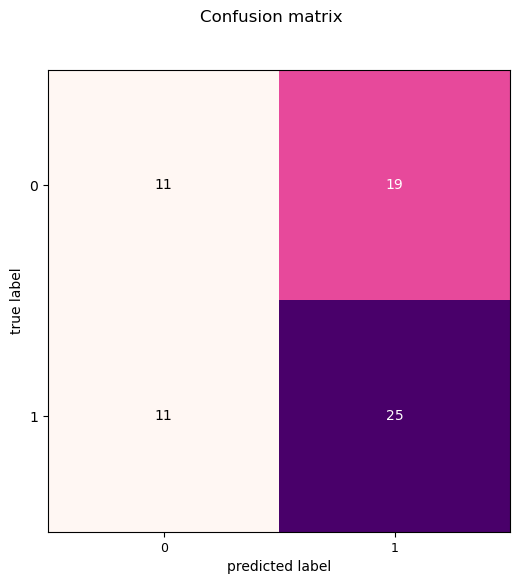

In [66]:
tree_clf = DecisionTreeClassifier()

## Use RandomizedSearchCV if GridSearchCV takes too long to compute.
# Finding the best hyperparameter through GridSearch.
param_grid = {
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': np.arange(2, 20),
    'min_samples_leaf': np.arange(1, 20),
    'criterion': ['gini', 'entropy'],
    'max_features': [None, 'sqrt', 'log2']
}

clf_search = GridSearchCV(tree_clf, param_grid, verbose=1)

clf_search.fit(X_scaled_smote_train, y_smote_train)
statistics(clf_search, X_scaled_smote_test, y_smote_test)

#### Logistic Regression

Accuracy: 0.621212
Precision: 0.641026
Recall: 0.694444
F1 score: 0.666667


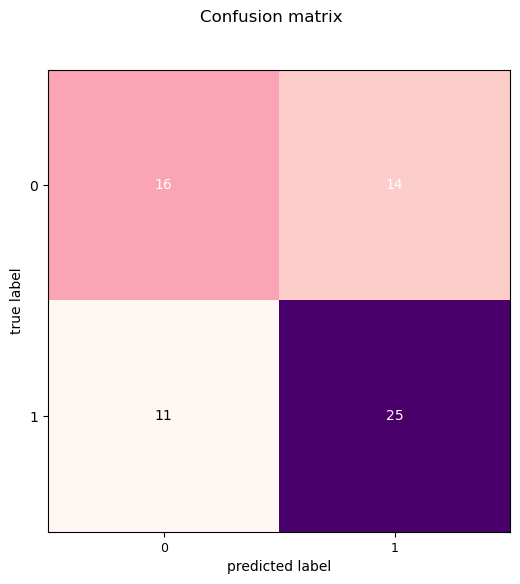

In [48]:
# Instance of the model, train and check results
logisticRegr_smote = LogisticRegression(max_iter=10000)
logisticRegr_smote.fit(X_scaled_smote_train, y_smote_train)
statistics(logisticRegr_smote, X_scaled_smote_test, y_smote_test)

In [49]:
# Get predictions array
predict_qualified_2023(logisticRegr_smote, scaled_23)

Model predicts 20 countries will make it to the final


,country,0
0,Norway,1
7,Switzerland,1
8,Israel,1
9,Moldova,1
10,Sweden,1
11,Azerbaijan,1
13,Netherlands,1
14,Finland,1
16,Armenia,1
17,Romania,1


#### RandomForest

Accuracy: 0.712121
Precision: 0.697674
Recall: 0.833333
F1 score: 0.759494


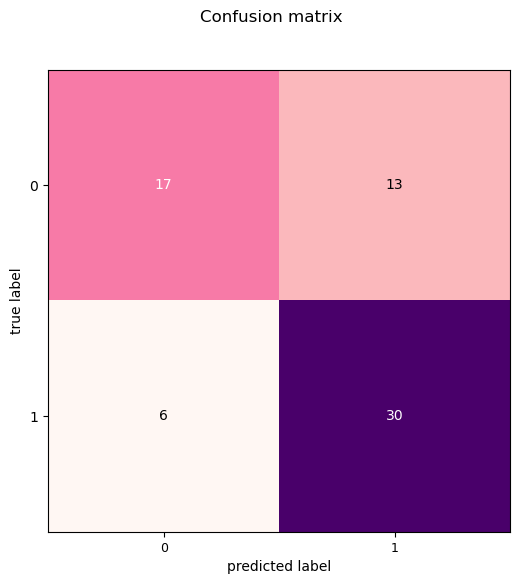

In [50]:
# Instance of the model, train and check results
rf_smote = RandomForestClassifier(n_estimators = 10000, random_state=42)
rf_smote.fit(X_smote_train, y_smote_train)
statistics(rf_smote,X_smote_test, y_smote_test)

In [51]:
# Get predictions array
predict_qualified_2023(rf_smote, scaled_23)

/home/marcus/miniforge3/envs/engineer-env/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Model predicts 17 countries will make it to the final


,country,0
1,Malta,1
5,Ireland,1
7,Switzerland,1
9,Moldova,1
10,Sweden,1
11,Azerbaijan,1
13,Netherlands,1
14,Finland,1
15,Denmark,1
16,Armenia,1


#### Neural Network

The Sigmoid function is commonly used for binary classification tasks as it maps the output to a probability value between 0 and 1. In this case, the sigmoid function will output a probability value that can be interpreted as the likelihood of a country qualifying, given the input features.


The binary cross-entropy loss function is commonly used for binary classification problems. This function is used to calculate the difference between the predicted probabilities and the actual binary labels.


For the optimizer, Adam is a popular choice as it's a variant of stochastic gradient descent (SGD) that dynamically adapts the learning rate based on the gradient values. 

In [52]:
# Instance of the model
model_nn_smote = tf.keras.Sequential([
    tf.keras.layers.Dense(32,  
        input_shape=(X_scaled_smote_train.shape[1],)),
    tf.keras.layers.Dense(32, 
        activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

# Compile the model
model_nn_smote.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

# Train the model
model_nn_smote.fit(X_scaled_smote_train, y_smote_train, 
          validation_data = (X_scaled_smote_test, y_smote_test),
          epochs=55, batch_size=64)

/home/marcus/miniforge3/envs/engineer-env/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/55


I0000 00:00:1729589807.675591  265075 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-10-22 11:36:47.676691: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2343] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.5438 - loss: 0.7777 - val_accuracy: 0.5000 - val_loss: 0.7449
Epoch 2/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.5879 - loss: 0.7201 - val_accuracy: 0.5000 - val_loss: 0.7280
Epoch 3/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.6421 - loss: 0.6702 - val_accuracy: 0.5152 - val_loss: 0.7165
Epoch 4/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.6778 - loss: 0.6249 - val_accuracy: 0.5455 - val_loss: 0.7106
Epoch 5/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6993 - loss: 0.6217 - val_accuracy: 0.5455 - val_loss: 0.7061
Epoch 6/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.7249 - loss: 0.5917 - val_accuracy: 0.5455 - val_loss: 0.7040
Epoch 7/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.7102 - loss: 0.5811 - val_accuracy: 0.5303 - val_loss: 0.7023
Epoch 8/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.6851 - loss: 0.5916 - val_accuracy: 0.5152 - val_loss: 0.7008
Epoch 9/55
6/6 

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


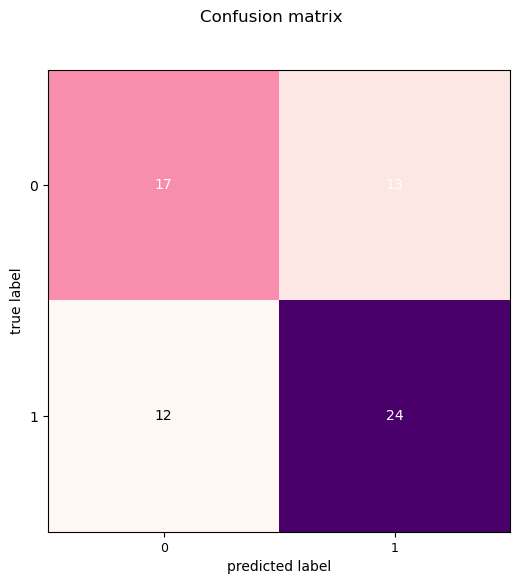

Accuracy: 0.621212
Precision: 0.648649
Recall: 0.666667
F1 score: 0.657534


In [53]:
# Check results
nn_statistics(model_nn_smote, X_scaled_smote_test, y_smote_test)

In [54]:
# Get predictions
pred_2023_nn_smote = model_nn_smote.predict(scaled_23).flatten()
countries = prediction_df['country']
top_nn_smote = pd.concat([countries, pd.DataFrame(pred_2023_nn_smote)], axis=1)
top_nn_smote.sort_values(by=[0], ascending = False).head(20)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


,country,0
13,Netherlands,0.981002
11,Azerbaijan,0.976958
10,Sweden,0.952143
16,Armenia,0.938064
30,Australia,0.932784
9,Moldova,0.931098
22,Greece,0.895530
7,Switzerland,0.862538
29,Lithuania,0.843584
14,Finland,0.841012


### Random OverSampling Dataset
#### Logistic Regression

Accuracy: 0.621212
Precision: 0.641026
Recall: 0.694444
F1 score: 0.666667


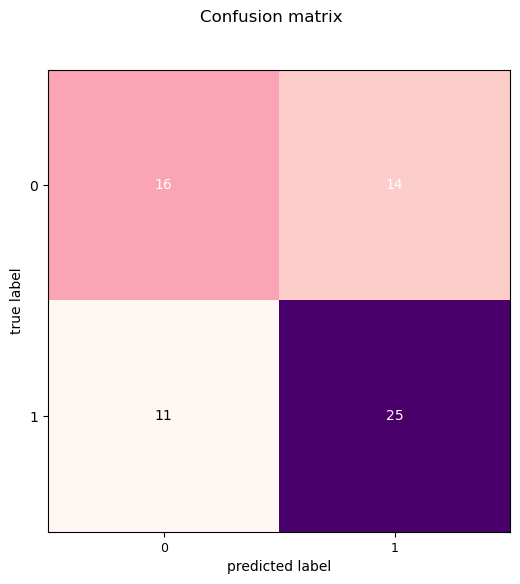

In [55]:
# Instance of the model, train and check results
logisticRegr_os = LogisticRegression(max_iter=10000)
logisticRegr_os.fit(X_scaled_os_train, y_upsampled_train)
statistics(logisticRegr_os, X_scaled_os_test, y_upsampled_test)

In [56]:
# Get predictions array
predict_qualified_2023(logisticRegr_os, scaled_23)

Model predicts 20 countries will make it to the final


,country,0
0,Norway,1
7,Switzerland,1
8,Israel,1
9,Moldova,1
10,Sweden,1
11,Azerbaijan,1
13,Netherlands,1
14,Finland,1
16,Armenia,1
17,Romania,1


#### RandomForest

Accuracy: 0.712121
Precision: 0.697674
Recall: 0.833333
F1 score: 0.759494


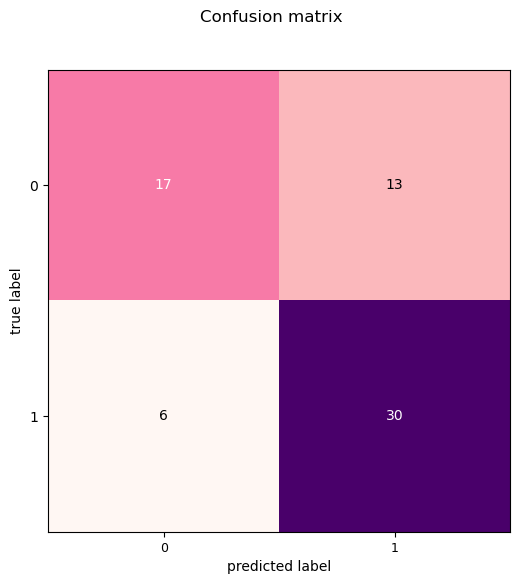

In [57]:
# Instance of the model, train and check results
rf_os = RandomForestClassifier(n_estimators = 10000, random_state=42)
rf_os.fit(X_scaled_os_train, y_upsampled_train)
statistics(rf_os,X_scaled_os_test, y_upsampled_test)

In [58]:
# Get predictions array
predict_qualified_2023(rf_os, scaled_23)

Model predicts 23 countries will make it to the final


,country,0
0,Norway,1
1,Malta,1
4,Portugal,1
7,Switzerland,1
8,Israel,1
9,Moldova,1
10,Sweden,1
11,Azerbaijan,1
13,Netherlands,1
14,Finland,1


In [59]:
# Get predictions
y_pred_prob = rf_smote.predict_proba(scaled_23)
y_pred = (y_pred_prob[:,1] >= 0.4).astype(int)
countries = prediction_df['country']
rf_ob_prob = pd.concat([countries, pd.DataFrame(y_pred)], axis = 1)
rf_ob_prob[rf_ob_prob[0]== 1]

/home/marcus/miniforge3/envs/engineer-env/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


,country,0
0,Norway,1
1,Malta,1
2,Serbia,1
3,Latvia,1
4,Portugal,1
5,Ireland,1
6,Croatia,1
7,Switzerland,1
8,Israel,1
9,Moldova,1


In [60]:
# Instance of the model
model_nn_os = tf.keras.Sequential([
    tf.keras.layers.Dense(32,  
        input_shape=(X_scaled_os_train.shape[1],)),
    tf.keras.layers.Dense(32, 
        activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    tf.keras.layers.Dense(1, activation='sigmoid')
])

# Compile the model
model_nn_os.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

# Train the model
model_nn_os.fit(X_scaled_os_train, y_upsampled_train, 
          validation_data = (X_scaled_os_test, y_upsampled_test),
          epochs=55, batch_size=64)

Epoch 1/55


/home/marcus/miniforge3/envs/engineer-env/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - accuracy: 0.5210 - loss: 0.7798 - val_accuracy: 0.5606 - val_loss: 0.8815
Epoch 2/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.6125 - loss: 0.6921 - val_accuracy: 0.5455 - val_loss: 0.8493
Epoch 3/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.6364 - loss: 0.6781 - val_accuracy: 0.5758 - val_loss: 0.8232
Epoch 4/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.6688 - loss: 0.6545 - val_accuracy: 0.5606 - val_loss: 0.8026
Epoch 5/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.7146 - loss: 0.6175 - val_accuracy: 0.5606 - val_loss: 0.7889
Epoch 6/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.6965 - loss: 0.6202 - val_accuracy: 0.5455 - val_loss: 0.7744
Epoch 7/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.7316 - loss: 0.5828 - val_accuracy: 0.5303 - val_loss: 0.7647
Epoch 8/55
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7399 - loss: 0.5753 - val_accuracy: 0.5303 - val_loss: 0.7545
Epoch 9/55
6/6 

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


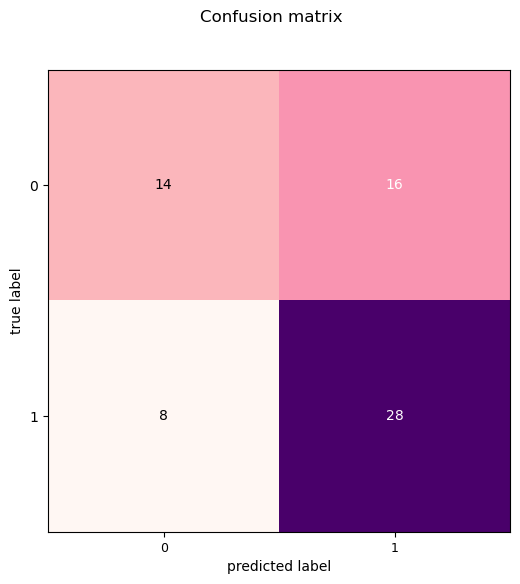

Accuracy: 0.636364
Precision: 0.636364
Recall: 0.777778
F1 score: 0.700000


In [61]:
# Check results
nn_statistics(model_nn_os, X_scaled_os_test, y_upsampled_test)

In [62]:
# Get predictions
pred_2023_nn_os = model_nn_os.predict(scaled_23).flatten()
top_nn_os = pd.concat([countries, pd.DataFrame(pred_2023_nn_os)], axis=1)
top_nn_os.sort_values(by=[0], ascending = False).head(20)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


,country,0
11,Azerbaijan,0.978423
30,Australia,0.947186
22,Greece,0.922282
10,Sweden,0.901272
28,Albania,0.899852
23,Poland,0.877646
13,Netherlands,0.867193
1,Malta,0.865387
20,Cyprus,0.812078
18,Estonia,0.790550
